Please note that I believe there might be some existing errors in coord extraction below. Indeed, part of the motivation of this exploration is to correct these errors and make it as easy as possible not to repeat them in user code.

In [1]:
import numpy as np
import pydicom
import xarray as xr

In [2]:
from pymedphys._data import download
from pymedphys._dicom import coords, dose

In [3]:
dicom_dose_filepath = download.get_file_within_data_zip(
    "dicom_dose_test_data.zip", "RD.wedge.dcm"
)
ds = pydicom.dcmread(dicom_dose_filepath)

In [4]:
dose = dose.dose_from_dataset(ds)
dose.shape

(60, 130, 75)

In [5]:
extents = coords.xyz_axes_from_dataset(ds, coord_system="IEC FIXED")

In [6]:
dose_arr = xr.DataArray(
    dose,
    coords = {
        'x': extents[0],
        'y': extents[1],
        'z': extents[2],
    },
    dims=['y', 'z', 'x'],
    name="dose",
    attrs={
        "units":"Gy",
        "long_name": "Dose to water from wedged field."
    }
)

In [7]:
dose_arr.x

<xarray.DataArray 'x' (x: 75)>
array([-49., -47., -45., -43., -41., -39., -37., -35., -33., -31., -29., -27.,
       -25., -23., -21., -19., -17., -15., -13., -11.,  -9.,  -7.,  -5.,  -3.,
        -1.,   1.,   3.,   5.,   7.,   9.,  11.,  13.,  15.,  17.,  19.,  21.,
        23.,  25.,  27.,  29.,  31.,  33.,  35.,  37.,  39.,  41.,  43.,  45.,
        47.,  49.,  51.,  53.,  55.,  57.,  59.,  61.,  63.,  65.,  67.,  69.,
        71.,  73.,  75.,  77.,  79.,  81.,  83.,  85.,  87.,  89.,  91.,  93.,
        95.,  97.,  99.])
Coordinates:
  * x        (x) float64 -49.0 -47.0 -45.0 -43.0 -41.0 ... 93.0 95.0 97.0 99.0

In [8]:
dose_arr.y

<xarray.DataArray 'y' (y: 60)>
array([211., 213., 215., 217., 219., 221., 223., 225., 227., 229., 231., 233.,
       235., 237., 239., 241., 243., 245., 247., 249., 251., 253., 255., 257.,
       259., 261., 263., 265., 267., 269., 271., 273., 275., 277., 279., 281.,
       283., 285., 287., 289., 291., 293., 295., 297., 299., 301., 303., 305.,
       307., 309., 311., 313., 315., 317., 319., 321., 323., 325., 327., 329.])
Coordinates:
  * y        (y) float64 211.0 213.0 215.0 217.0 ... 323.0 325.0 327.0 329.0

In [9]:
dose_arr.z

<xarray.DataArray 'z' (z: 130)>
array([  1.,   3.,   5.,   7.,   9.,  11.,  13.,  15.,  17.,  19.,  21.,  23.,
        25.,  27.,  29.,  31.,  33.,  35.,  37.,  39.,  41.,  43.,  45.,  47.,
        49.,  51.,  53.,  55.,  57.,  59.,  61.,  63.,  65.,  67.,  69.,  71.,
        73.,  75.,  77.,  79.,  81.,  83.,  85.,  87.,  89.,  91.,  93.,  95.,
        97.,  99., 101., 103., 105., 107., 109., 111., 113., 115., 117., 119.,
       121., 123., 125., 127., 129., 131., 133., 135., 137., 139., 141., 143.,
       145., 147., 149., 151., 153., 155., 157., 159., 161., 163., 165., 167.,
       169., 171., 173., 175., 177., 179., 181., 183., 185., 187., 189., 191.,
       193., 195., 197., 199., 201., 203., 205., 207., 209., 211., 213., 215.,
       217., 219., 221., 223., 225., 227., 229., 231., 233., 235., 237., 239.,
       241., 243., 245., 247., 249., 251., 253., 255., 257., 259.])
Coordinates:
  * z        (z) float64 1.0 3.0 5.0 7.0 9.0 ... 251.0 253.0 255.0 257.0 259.0

In [10]:
# Need method="nearest" if exact coordinate isn't suppled to sel():
try:
    dose_arr.sel(x=0)
except KeyError:
    print("KeyError")

KeyError


In [11]:
dose_arr.sel(x=0, method="nearest")

<xarray.DataArray 'dose' (y: 60, z: 130)>
array([[0.        , 0.        , 0.        , ..., 0.27924936, 0.27602001,
        0.27234213],
       [0.        , 0.        , 0.        , ..., 0.31979569, 0.31611781,
        0.31178211],
       [0.        , 0.        , 0.        , ..., 0.33671989, 0.33283271,
        0.32822789],
       ...,
       [0.        , 0.        , 0.        , ..., 0.05558674, 0.05525782,
        0.05552694],
       [0.        , 0.        , 0.        , ..., 0.05113143, 0.05089222,
        0.0506231 ],
       [0.        , 0.        , 0.        , ..., 0.04539036, 0.04530065,
        0.04518105]])
Coordinates:
    x        float64 1.0
  * y        (y) float64 211.0 213.0 215.0 217.0 ... 323.0 325.0 327.0 329.0
  * z        (z) float64 1.0 3.0 5.0 7.0 9.0 ... 251.0 253.0 255.0 257.0 259.0
Attributes:
    units:      Gy
    long_name:  Dose to water from wedged field.

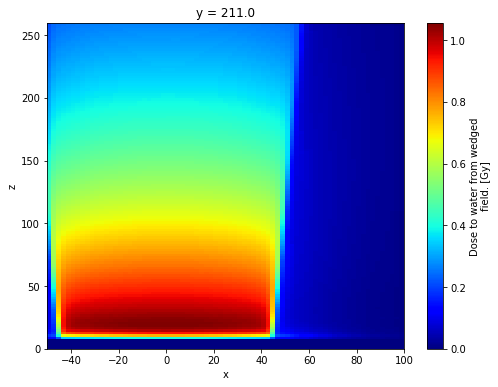

In [12]:
# Very easily plot dose slice, already labelled with colorbar and units
dose_arr.sel(y=0, method="nearest").plot(cmap="jet", figsize=(8,6), aspect="equal") #Notice we asked for y=0, but plotting y=211 (closest slice)

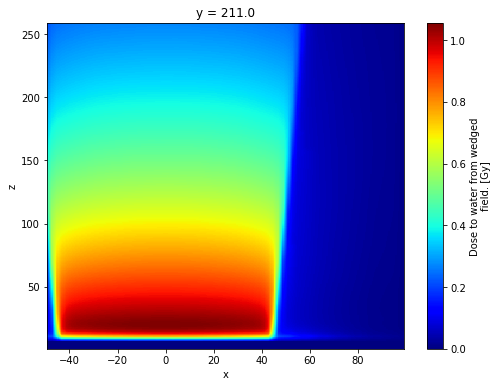

In [13]:
# Lovely inbuilt interpolation too!

x_new = np.linspace(dose_arr.x[0], dose_arr.x[-1], dose_arr.sizes["x"]*4) # Make 4x finer
y_new = np.linspace(dose_arr.y[0], dose_arr.y[-1], dose_arr.sizes["y"]*4) # Make 4x finer
z_new = np.linspace(dose_arr.z[0], dose_arr.z[-1], dose_arr.sizes["z"]*4) # Make 4x finer

dose_arr_interp = dose_arr.interp(x=x_new, y=y_new, z=z_new)
dose_arr_interp.sel(y=0, method="nearest").plot(cmap="jet", figsize=(8,6), aspect="equal")

In [14]:
# Can perhaps add coordinate system and patient orientation (where applicable) as attrs?

dose_arr.attrs["coord_system"]="IEC FIXED"
dose_arr.attrs["orientation"]="HFS"
dose_arr # see bottom

<xarray.DataArray 'dose' (y: 60, z: 130, x: 75)>
array([[[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.21956613, 0.24620829, 0.25586645, ..., 0.01722322,
         0.01291741, 0.00861161],
        [0.21708431, 0.24339756, 0.25296601, ..., 0.01716342,
         0.01288751, 0.00858171],
        [0.21418387, 0.2401084 , 0.24955725, ..., 0.00855181,
         0.00642881, 0.0042759 ]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
...
        [0.03459594, 0.03597141, 0.03737678, ..., 0.00723614,
         0.00544206, 0.00361807],
        [0.03441653, 0.035792  , 0.03719737, ..., 0.00723614,
         0.00544206, 0.00361807],
        [0.03423713, 0.03603121, 0.03698806, ..., 0.00361807,
         0.00272103, 0.00179409]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.0316656 , 0.03301117, 0.0336391 , ..., 0.00361807,
         0.00272103, 0.00182399],
        [0.0315759 , 0.03295136, 0.03357929, ..., 0.00361807,
         0.00272103, 0.00182399],
        [0.0314862 , 0.03283176, 0.03345969, ..., 0.00179409,
         0.00134556, 0.00089704]]])
Coordinates:
  * x        (x) float64 -49.0 -47.0 -45.0 -43.0 -41.0 ... 93.0 95.0 97.0 99.0
  * y        (y) float64 211.0 213.0 215.0 217.0 ... 323.0 325.0 327.0 329.0
  * z        (z) float64 1.0 3.0 5.0 7.0 9.0 ... 251.0 253.0 255.0 257.0 259.0
Attributes:
    units:         Gy
    long_name:     Dose to water from wedged field.
    coord_system:  IEC FIXED
    orientation:   HFS

In [15]:
# And then use swap_dims() and negations where required to change coord_system?
 
def change_xarray_coord_system_from_fixed_to_dicom(dose_arr): # generalise in lib but just demo for now
    
    new_dose_arr = dose_arr.rename(
        {
            "z": "y",
            "y": "z"
        }
    )

    new_dose_arr["y"] = -new_dose_arr["y"]
    new_dose_arr.attrs["coord_system"] = "DICOM"

    return new_dose_arr

In [16]:
dose_arr.coords

Coordinates:
  * x        (x) float64 -49.0 -47.0 -45.0 -43.0 -41.0 ... 93.0 95.0 97.0 99.0
  * y        (y) float64 211.0 213.0 215.0 217.0 ... 323.0 325.0 327.0 329.0
  * z        (z) float64 1.0 3.0 5.0 7.0 9.0 ... 251.0 253.0 255.0 257.0 259.0

In [17]:
dose_arr_dicomCS = change_xarray_coord_system_from_fixed_to_dicom(dose_arr)

dose_arr_dicomCS.coords # Note swapping of y and z (DICOM at HFS) and negative y values (positive z before)

Coordinates:
  * x        (x) float64 -49.0 -47.0 -45.0 -43.0 -41.0 ... 93.0 95.0 97.0 99.0
  * z        (z) float64 211.0 213.0 215.0 217.0 ... 323.0 325.0 327.0 329.0
  * y        (y) float64 -1.0 -3.0 -5.0 -7.0 ... -253.0 -255.0 -257.0 -259.0

In [18]:
dose_arr_dicomCS.attrs["coord_system"]

'DICOM'

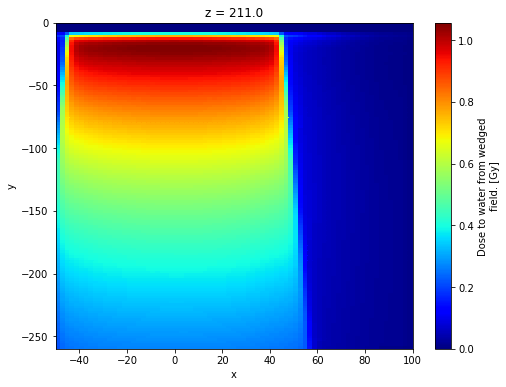

In [19]:
# Notice this is the same slice as before (since we chose z=0), but labelled according to the new (DICOM) coord system. It is flipped vertically because the 'y' in DICOM is negative relative to 'z" in IEC FIXED. The plot function sorts the ordinate labels to be increasing from the bottom, and flips the dose data accordingly. Not sure where this is happening but should be easy to either disable or workaround (I think people are used to visualising in a FIXED system, so I believe it is better to simply reverse labels). 
dose_arr_dicomCS.sel(z=0, method="nearest").plot(cmap="jet", figsize=(8,6), aspect="equal") 